**Course**: Big Data and Cloud Computing<br>
**Group Members**: Alexandre L'HER, Raymond KLUTSE <br>
**Date**: 21st January 2020<br>
**Project**: Typhoons<br>



**Before starting:**

You need to install Basemap. Do it only once.

In [0]:
%%bash
apt-get install libgeos-3* libgeos-dev
pip install https://github.com/matplotlib/basemap/archive/master.zip

Reading package lists...
Building dependency tree...
Reading state information...
libgeos-3.6.2 is already the newest version (3.6.2-1build2).
libgeos-3.6.2 set to manually installed.
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
Suggested packages:
  libgdal-doc
The following NEW packages will be installed:
  libgeos-dev
0 upgraded, 1 newly installed, 0 to remove and 7 not upgraded.
Need to get 73.1 kB of archives.
After this operation, 486 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libgeos-dev amd64 3.6.2-1build2 [73.1 kB]
Fetched 73.1 kB in 0s (168 kB/s)
Selecting previously unselected package libgeos-dev.
(Reading database ... 135004 files and directories currently installed.)
Preparing to unpack .../libgeos-dev_3.6.2-1build2_amd64.deb ...
Unpacking libgeos-dev (3.6.2-1build2) ...
Setting up libgeos-dev (3.6.2-1build2) ...
Processing t

In [0]:
%matplotlib inline
%pylab inline
from mpl_toolkits.basemap import Basemap
import sklearn
import numpy as np
import pandas as pd
from scipy.stats.mstats import zscore
import warnings
from scipy.interpolate import interpn
warnings.filterwarnings("ignore") # disable warnings
pylab.rcParams['figure.figsize']=(20,20) # graph size

Populating the interactive namespace from numpy and matplotlib


**Declare functions:**
- plot_im (plot satellite image with geographic coordinates)
- plot_ts (plot time series)

In [0]:
# function to plot images  
def plot_im(lon,lat,im,size_points,var_name, vmin, vmax):
    
    # transform to arrays (just in case)
    lon=array(lon)
    lat=array(lat)
    im=array(im)
    
    if max(lon)-min(lon)<100:
      # Mercator projection (for small zone)
      m=Basemap(projection='merc',llcrnrlat=nanmin(lat),urcrnrlat=nanmax(lat),\
                llcrnrlon=nanmin(lon),urcrnrlon=nanmax(lon),lat_0=(nanmax(lat)+nanmin(lat))*0.5,\
                lon_0=(nanmax(lon)+nanmin(lon))*0.5,resolution='l')
    else:
      # Orthogonal projection (for large zone)
      m=Basemap(projection='ortho',lat_0=0,lon_0=0,resolution='l')
    # you can use other projections (see https://matplotlib.org/basemap/users/mapsetup.html)
    
    # transform (lon,lat) to (x,y)
    x,y=m(lon,lat)

    # plot
    im=ma.masked_where(isnan(im),im)
    res=m.scatter(x,y,size_points,im,'o',alpha=1,cmap='jet',lw=0, vmin = vmin, vmax = vmax)
    m.drawcoastlines()
    m.fillcontinents()
    parallels = linspace(nanmin(lat),nanmax(lat),15)
    meridians = linspace(nanmin(lon),nanmax(lon),15)
    #m.drawparallels(parallels,labels=[1,0,0,1],fontsize=10)
    #m.drawmeridians(meridians,labels=[1,0,0,1],fontsize=10)
    cb=m.colorbar(res,location="right")
    cb.set_label(var_name,fontsize=15)
    
# function to plot time series
def plot_ts(time,ts,line_type,var_name):

    # plot
    plot_date(time,ts,line_type)
    xlabel('Time',fontsize=15)
    ylabel(var_name,fontsize=15)

**Connection to the GCP:**

First, we have to connect to the Google Cloud Platform. using the following command. Enter the login "bigdataocean2020@gmail.com" and password "bdoimt2020_mce". Do it only once.

In [0]:
from google.colab import auth
auth.authenticate_user()

Use BigQuery to get the mean sst and standard deviation of sst as a function of time for the desired area of study

In [0]:
%%bigquery --project alert-ground-261008 output
SELECT time,AVG(sst) AS mean_sst,AVG(ssh) AS mean_ssh, STDDEV(sst) as var_sst
FROM bdo2020.bdo2020.1998_2015
WHERE lon>=120 AND lon<=140 AND lat>=20 AND lat<40
GROUP BY time
ORDER BY time

Convert time to day, month and years

In [0]:
output['day'] = output.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
output['month'] = output.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
output['year'] = output.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

output.head()

,time,mean_sst,mean_ssh,var_sst,day,month,year
0,729390.0,20.923028,1.147679,4.631707,1,1,1998
1,729391.0,20.935389,1.145255,4.630403,2,1,1998
2,729392.0,20.924317,1.142865,4.610327,3,1,1998
3,729393.0,21.009176,1.141091,4.416243,4,1,1998
4,729394.0,21.139232,1.139875,4.422380,5,1,1998


We define functions to calculate differences

In [0]:
def diff_mean(df,i) :
  return df.mean_sst.diff(periods=i).fillna(0)

def diff_var(df,i) :
  return df.var_sst.diff(periods=i).fillna(0)

Define a function to select only part of the data, or all the data. This function also does the difference and plots the result

In [0]:
def plot_per_year(df,start, end, i):
  if start != end : 
    new_df = df.loc[df['year'].between(start,end)]
    new_df.reset_index(inplace = True) 
    new_df = new_df.drop(columns=['index'])
    figure(figsize=(8,8))
    subplot(2,1,1)
    plot_ts(new_df.time[:],diff_mean(new_df,i),'-*','mean SST ')
    subplot(2,1,2)
    plot_ts(new_df.time[:],diff_var(new_df,i),'-*','var SST ')
   
  else : 
    new_df = df.loc[df['year']== start]
    new_df.reset_index(inplace = True) 
    new_df = new_df.drop(columns=['index'])
    figure(figsize=(8,8))
    subplot(2,1,1)
    plot_ts(new_df.time[:],diff_mean(new_df,i),'-*','mean SST ')
    subplot(2,1,2)
    plot_ts(new_df.time[:],diff_var(new_df,i),'-*','var SST ')
    
  return new_df

We took data for 10 years from 2003 to 2013. Due to a change of satellite in 2002 there is a problem with sst data so we chose to ignore data before that.
We took a 3 days difference to detect changes

(4018, 7)

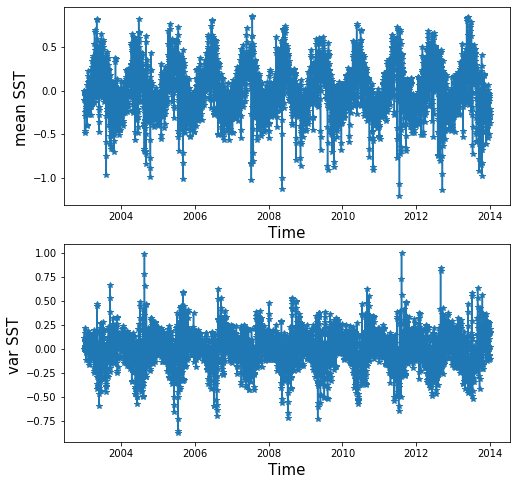

In [0]:
diff_n = 3
out_per_yr = plot_per_year(output,2003,2013,diff_n)

Linear Regression of the difference

In [0]:
t = np.arange(0,out_per_yr.shape[0],1)
x1 = np.ones((out_per_yr.shape[0],))
x2 = t
x3 = np.sin(2*np.pi*t/365.25)
x4 = np.cos(2*np.pi*t/365.25)

In [0]:
from sklearn.linear_model import LinearRegression

X = np.vstack((x1,x2,x3,x4)).T
print('The shape of X is {}'.format(X.shape))
print('The shape of y is {}'.format(out_per_yr['mean_sst'].shape))

model_mean = LinearRegression()
model_var = LinearRegression()

#fit the model
model_mean.fit(X,diff_mean(out_per_yr,diff_n))
model_var.fit(X,diff_var(out_per_yr,diff_n))

The shape of X is (4018, 4)
The shape of y is (4018,)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

No handles with labels found to put in legend.
No handles with labels found to put in legend.


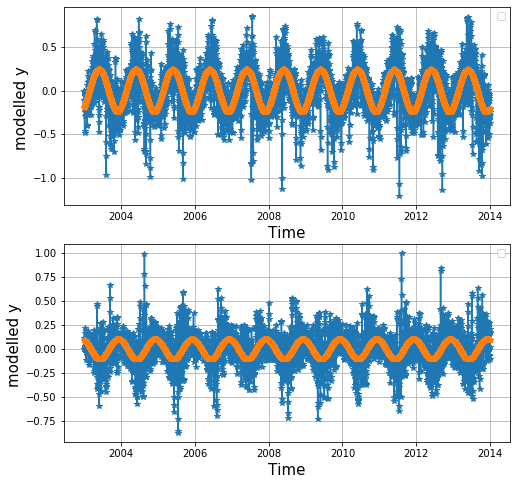

In [0]:
#get predicted values for y
y_hat_mean = model_mean.predict(X)
y_hat_var = model_var.predict(X)

plt.figure(figsize=(8,8))
subplot(2,1,1)
plot_ts(out_per_yr.time[:],diff_mean(out_per_yr,diff_n),'-*','mean SST ')
plot_ts(out_per_yr.time[:],y_hat_mean,'-*','modeled mean sst ')
plt.legend()
plt.grid()
subplot(2,1,2)
plot_ts(out_per_yr.time[:],diff_var(out_per_yr,diff_n),'-*','std SST ')
plot_ts(out_per_yr.time[:],y_hat_var,'-*','modeled std sst')
plt.legend()
plt.grid()

Now we substract the model from the data to get only peaks representing the differences over 3 days

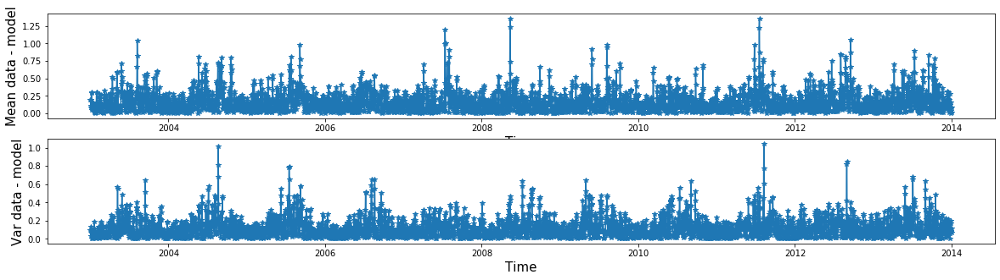

In [0]:
sst_diff_mean = diff_mean(out_per_yr,diff_n) - y_hat_mean
sst_diff_var =diff_var(out_per_yr,diff_n) - y_hat_var
plt.figure(figsize=(20,5))
subplot(2,1,1)
plot_ts(out_per_yr.time[:],np.abs(sst_diff_mean),'-*','Mean data - model')
subplot(2,1,2)
plot_ts(out_per_yr.time[:],np.abs(sst_diff_var),'-*','Var data - model')

Normalize the data, define a radius in standard deviation and mean.
Plot std in function of mean.

The points anomalies above a chosen radius are considered as typhoons. the radius was arbitrary, such that we ignore the high density region.

Text(0, 0.5, 'diff sst var')

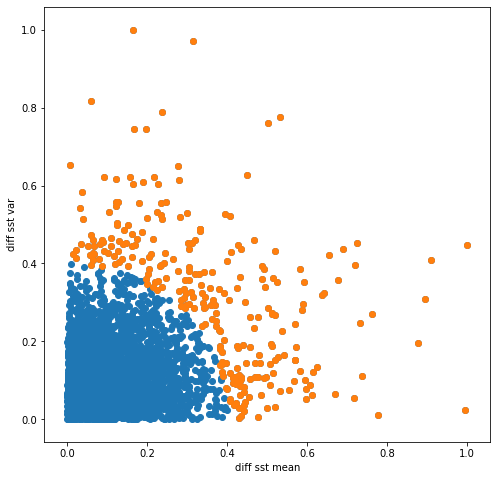

In [0]:
sst_mean_n = np.abs(sst_diff_mean) / np.max(np.abs(sst_diff_mean))
sst_var_n = np.abs(sst_diff_var) / np.max(np.abs(sst_diff_var))

r_m = np.sqrt(sst_mean_n**2 + sst_var_n**2)

mean_m = sst_mean_n[r_m > .4]
var_m = sst_var_n[r_m > .4]

plt.figure(figsize=(8,8))

scatter(sst_mean_n,sst_var_n)
xlabel('diff sst mean')
ylabel('diff sst var')

scatter(np.abs(mean_m),np.abs(var_m))
xlabel('diff sst mean')
ylabel('diff sst var')

Get the dates of the detected typhoons and convert it to human readable dates

In [0]:
pos_time = out_per_yr.time[r_m > 0.4]
df_typhoon = pd.DataFrame(data=list(pos_time),columns = ['time'])
df_typhoon['day'] = df_typhoon.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
df_typhoon['month'] = df_typhoon.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
df_typhoon['year'] = df_typhoon.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

3142    734358.0
Name: time, dtype: float64

In [0]:
df_typhoon

,time,day,month,year
0,731319.0,14,4,2003
1,731340.0,5,5,2003
2,731341.0,6,5,2003
3,731343.0,8,5,2003
4,731344.0,9,5,2003
...,...,...,...,...
265,735150.0,9,10,2013
266,735155.0,14,10,2013
267,735156.0,15,10,2013
268,735157.0,16,10,2013


Plot the number of "typhoon days" per month on the 10 years data

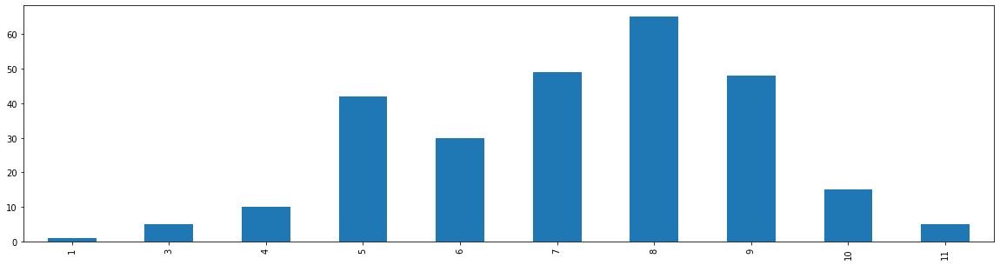

In [0]:
plt.figure(figsize=(20,5))
df_typhoon.month.value_counts(sort = False).plot(kind='bar',title = "")

We do the difference in the days where typhoons were detected. If the difference is 1, it means that a typhoon was detected 2 successive days.
We suppose that if a typhoon was detected 2 successive days, it is the same typhoon (quite strong supposition). This way we can count the total number of typhoon instead of the number of "typhoon days"

In [0]:
df_typhoon["difference"] = df_typhoon["time"].diff(1).fillna(0)
plt.figure(figsize=(25,5))
print("NUmber of Typhoons per year")
df_typhoon.loc[df_typhoon.difference != 1].year.value_counts(sort = False).head()

NUmber of Typhoons per year


2003     9
2004    15
2005    13
2006     5
2007     7
Name: year, dtype: int64

<Figure size 1800x360 with 0 Axes>

Now we can plot the number of typhoons per year

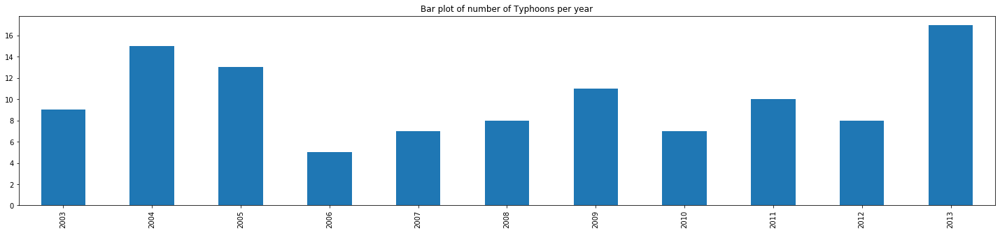

In [0]:
plt.figure(figsize=(25,5))
df_typhoon.loc[df_typhoon.difference != 1].year.value_counts(sort = False).plot(kind='bar', title="Bar plot of number of Typhoons per year")

And the number of typhoons per month, over the 10 years of data

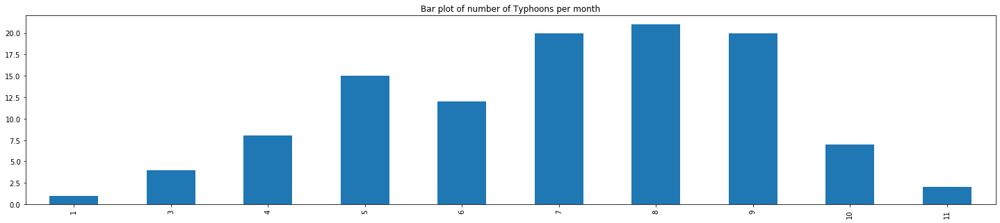

In [0]:
plt.figure(figsize=(25,5))
df_typhoon.loc[df_typhoon.difference != 1].month.value_counts(sort = False).plot(kind='bar', title="Bar plot of number of Typhoons per month")

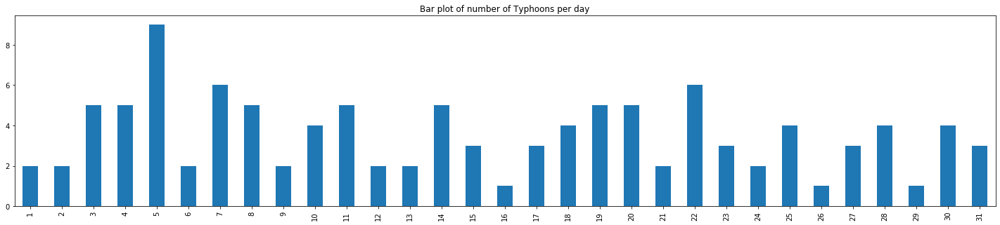

In [0]:
plt.figure(figsize=(25,5))
df_typhoon.loc[df_typhoon.difference != 1].day.value_counts(sort = False).plot(kind='bar', title="Bar plot of number of Typhoons per day")

**Tracking Typhoons**

As we had no more time to track the typhoons, we decided instead to manually plot the SST at times where a typhoon was detected.
We took data 7 days before and 15 days after the detection, taken manually from the time array of detected typhoons

In [0]:
%%bigquery --project alert-ground-261008 output1
SELECT time, lon, lat, sst AS sst_t
FROM bdo2020.bdo2020.1998_2015
WHERE lon>=120 AND lon<=160 AND lat>=10 AND lat<40 AND time > 735155.0-7 AND time < 735155.0+15
ORDER BY time

In [0]:
sst_im = output1.groupby(['time','lon', 'lat'])['sst_t'].mean()
lon_im = output1.groupby(['lon', 'lat'])['lon'].mean()
lat_im = output1.groupby(['lon', 'lat'])['lat'].mean()

In [0]:
output1.time.unique()
output1['day'] = output1.time.apply(lambda x:datetime.date.fromordinal(int(x)).day)
output1['month'] = output1.time.apply(lambda x:datetime.date.fromordinal(int(x)).month)
output1['year'] = output1.time.apply(lambda x:datetime.date.fromordinal(int(x)).year)

In [0]:
output1.head()

,time,lon,lat,sst_t,day,month,year
0,735149.0,155.875,10.125,30.0,8,10,2013
1,735149.0,156.125,10.125,30.0,8,10,2013
2,735149.0,156.625,10.125,30.0,8,10,2013
3,735149.0,156.875,10.125,30.0,8,10,2013
4,735149.0,157.125,10.125,30.0,8,10,2013


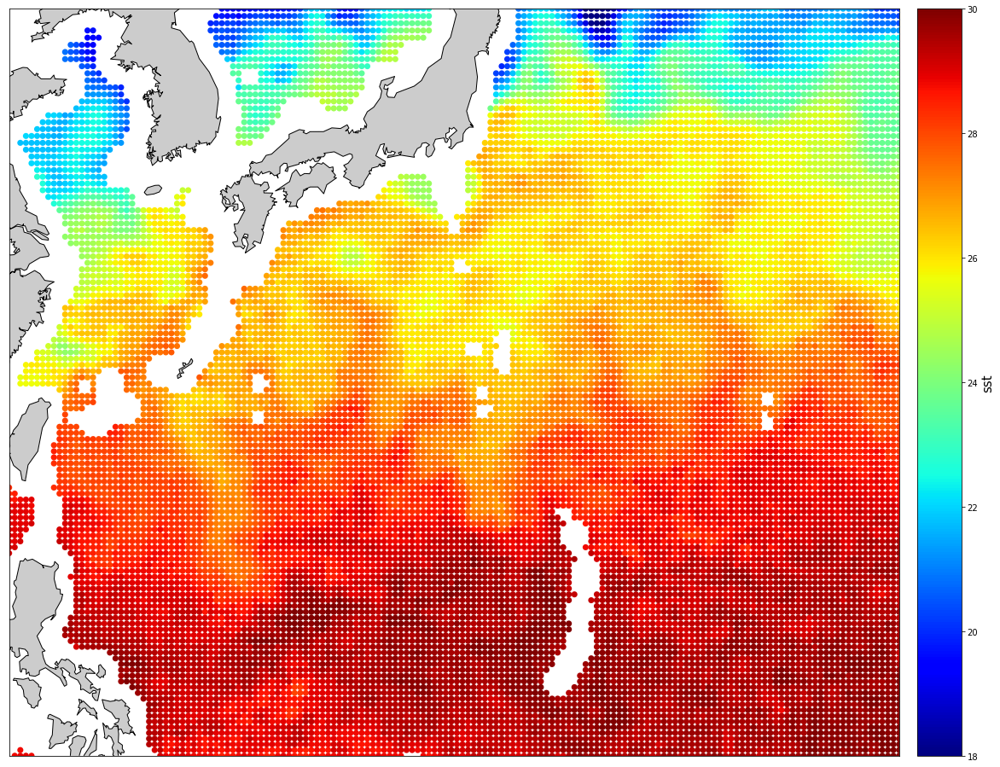

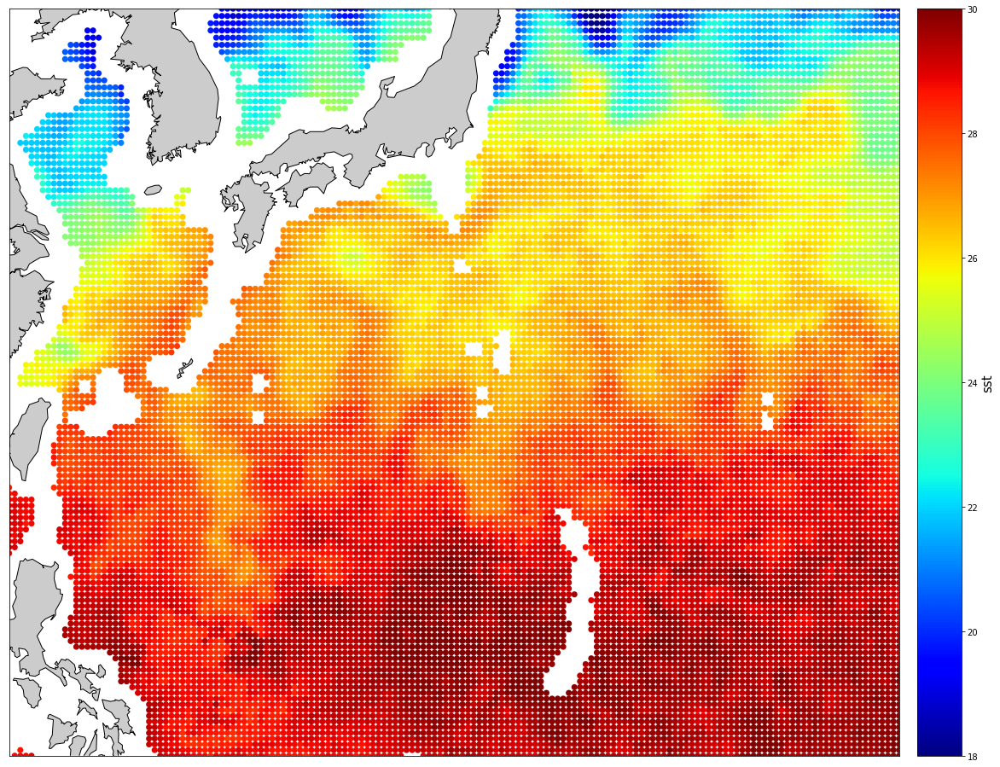

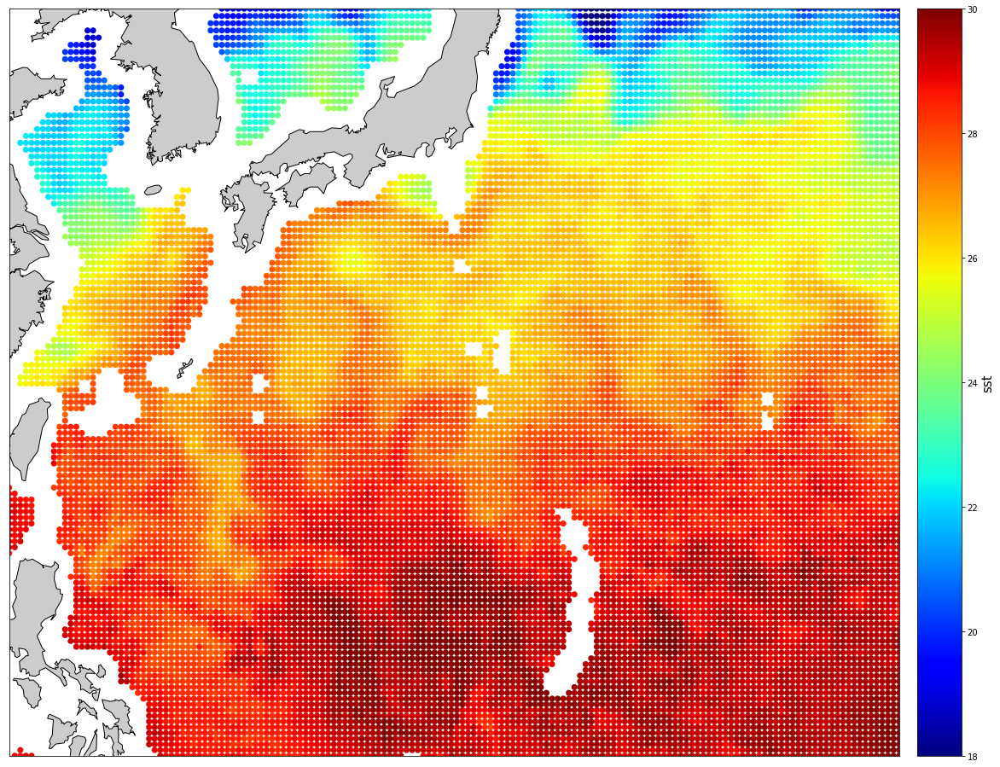

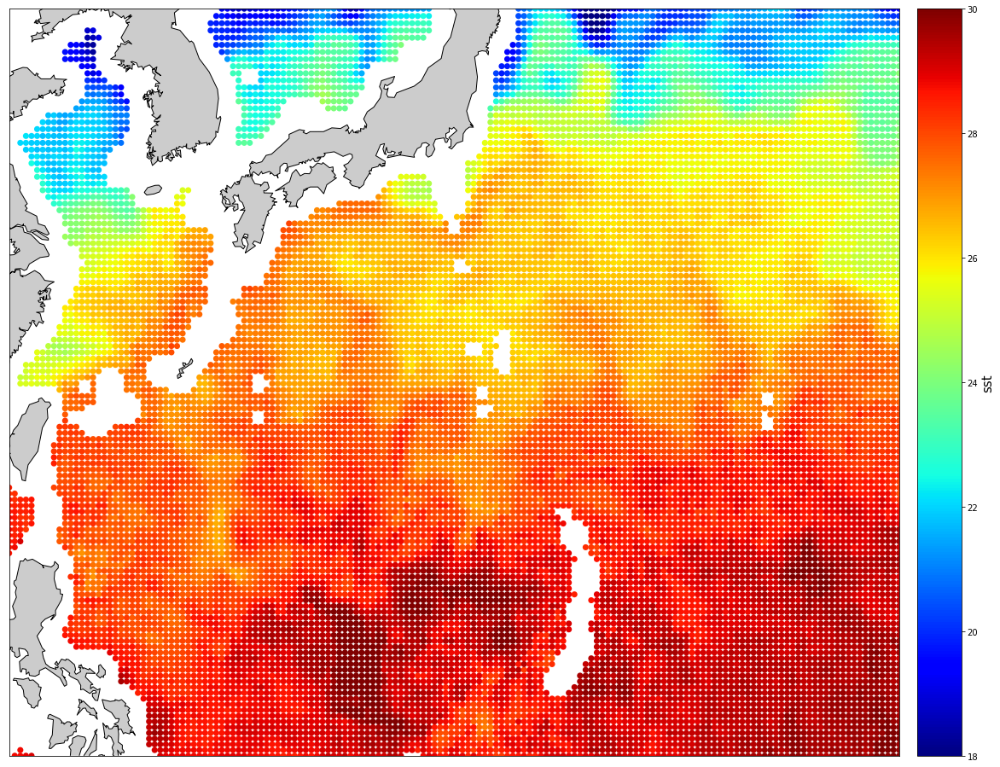

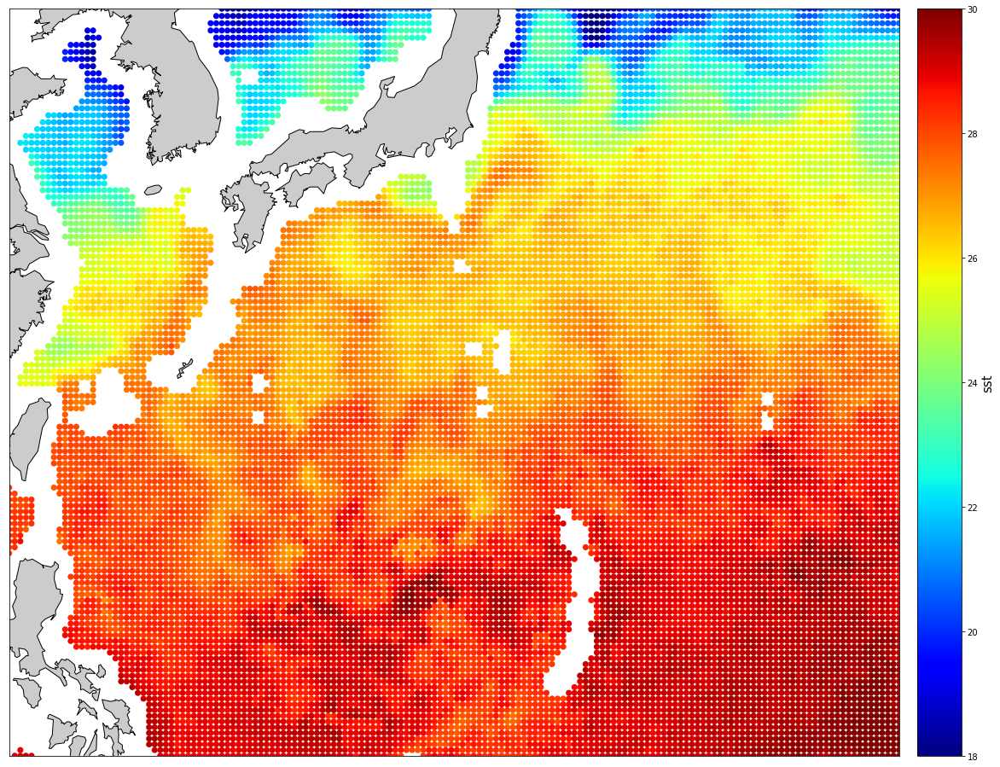

...

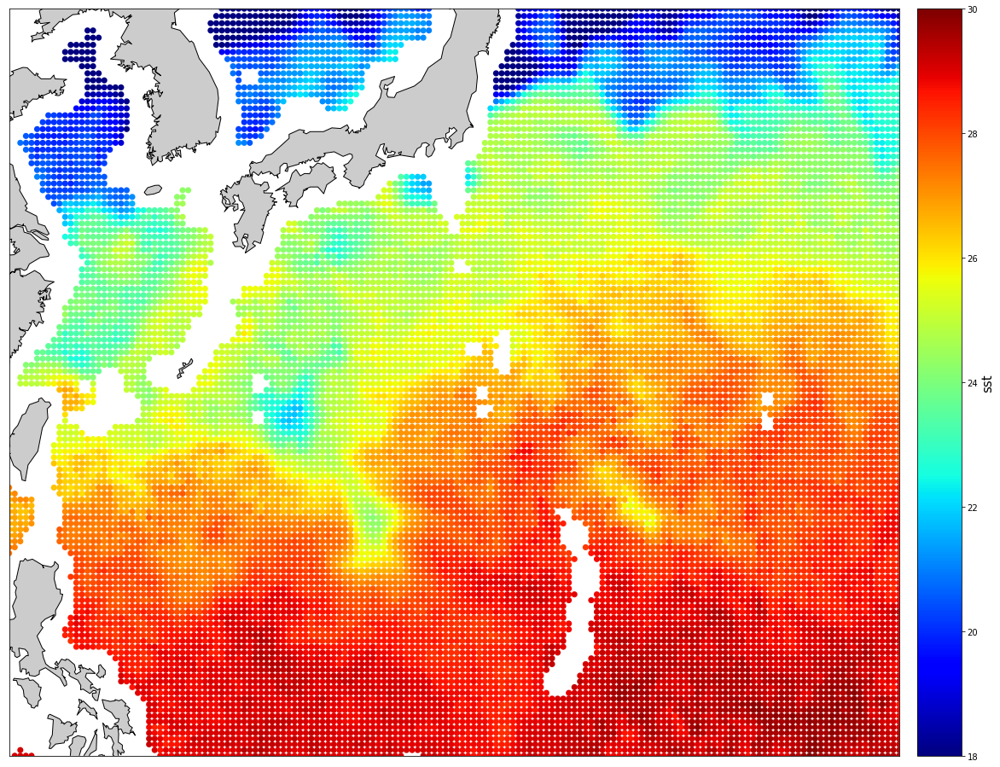

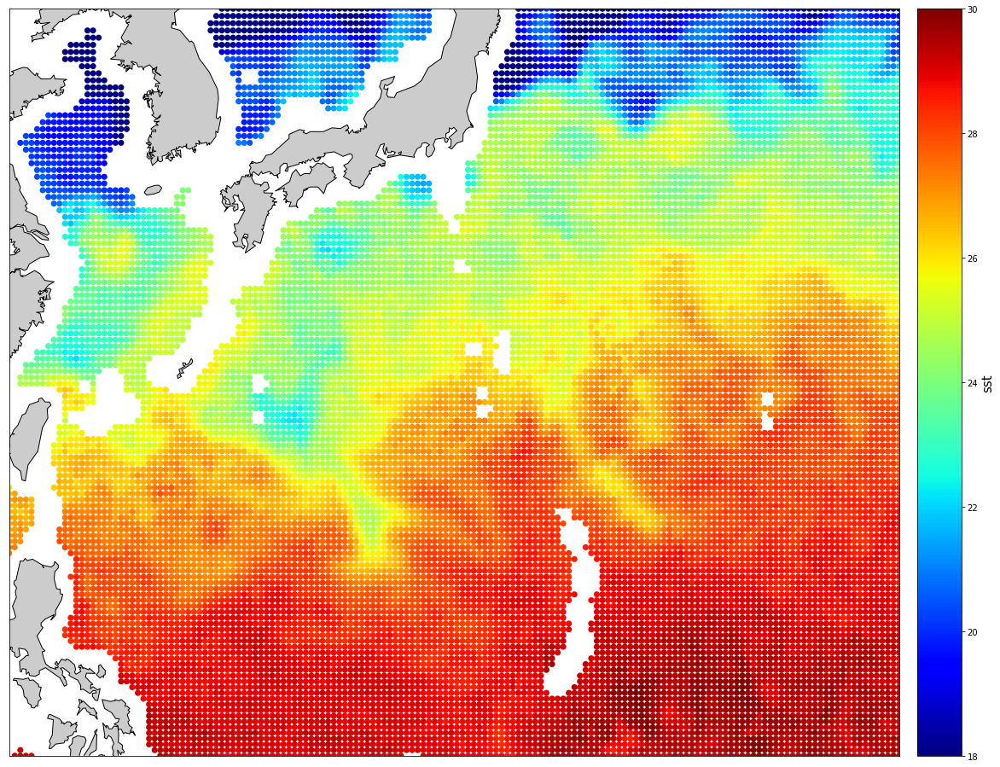

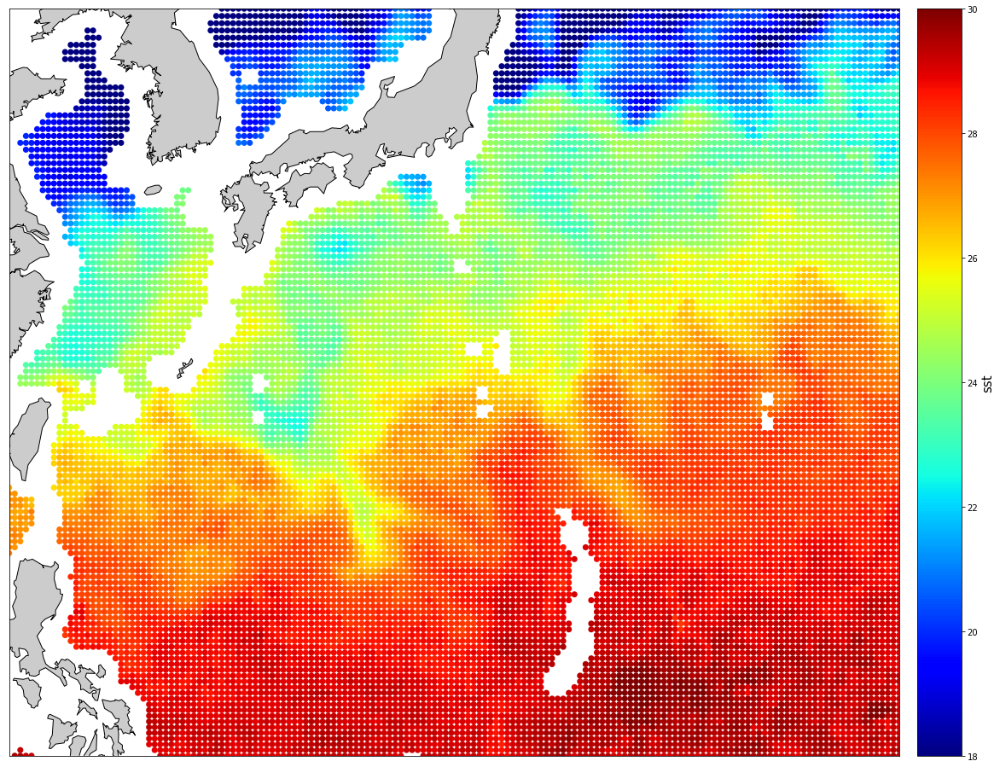

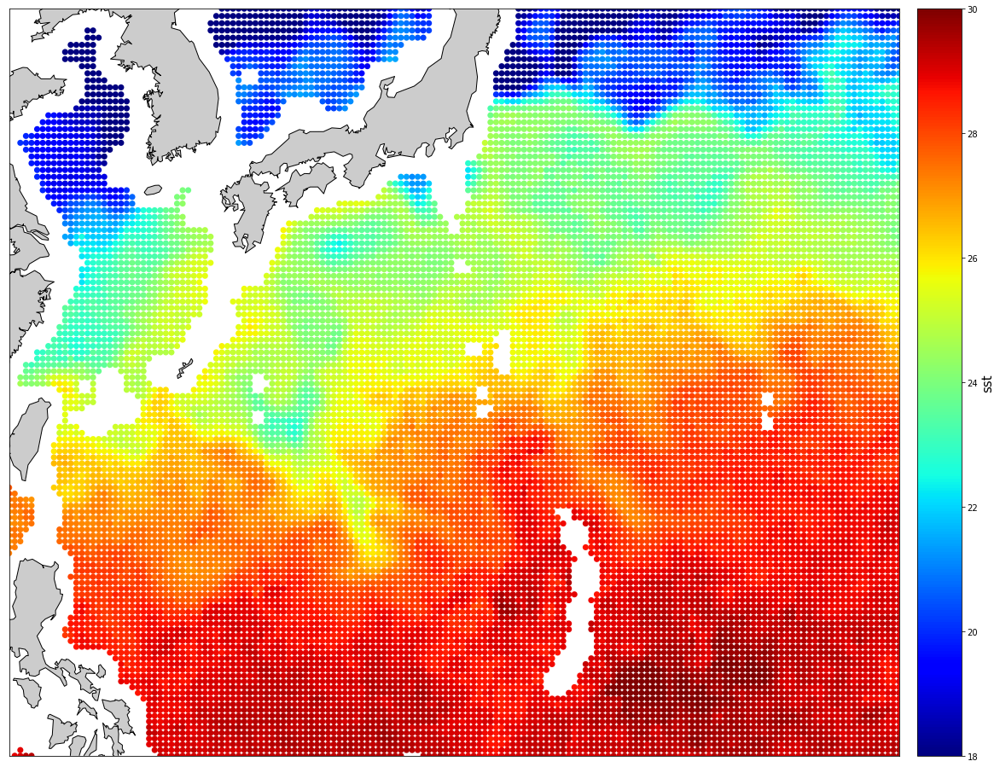

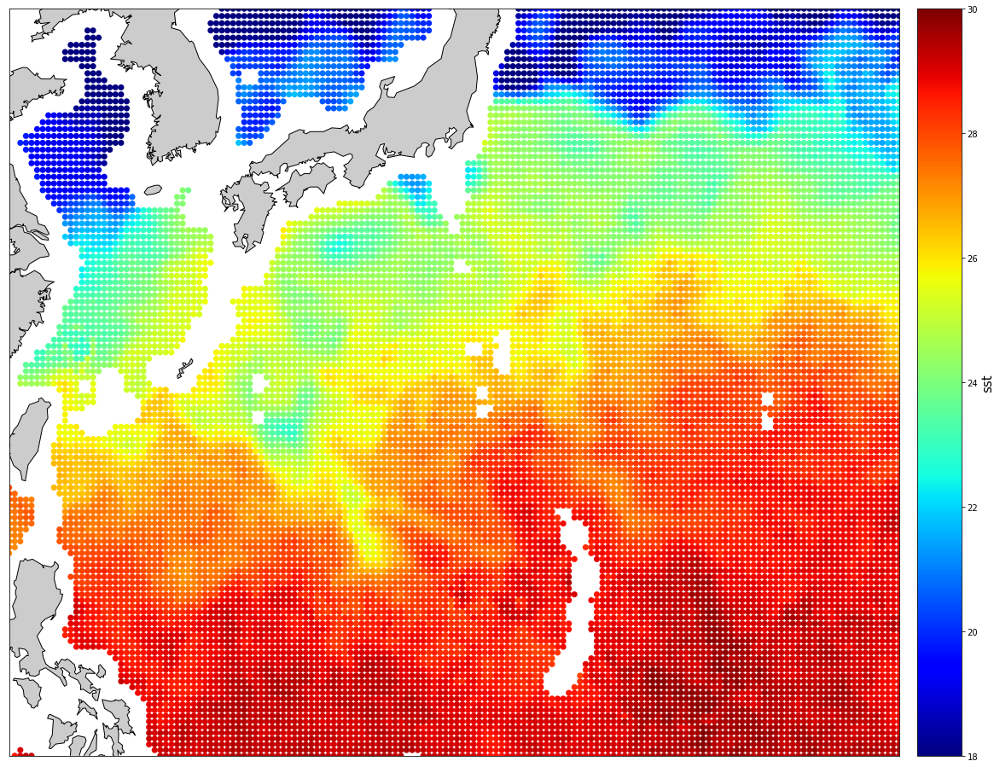

In [0]:
for i in output1.time.unique() :
  plot_im(lon_im, lat_im, sst_im[i], 50, 'sst', 18, 30)
  fig1 =  plt.gcf()
  plt.show()
  fig1.savefig('/content/drive/My Drive/'+ 'foo' + str(int(i))+'.png')